In [28]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import precision_score
import pandas as pd
import seaborn as sns
from statsmodels import api as sm
from matplotlib import pyplot as plt
from pandas.plotting import register_matplotlib_converters
import os
import numpy as np
import math
import validate
from sklearn.preprocessing import StandardScaler
import PR_curve
import extract_sound
from sklearn.manifold import TSNE

In [6]:
data_dir='fixed_csv_label_ver2'
df = pd.read_csv( os.path.join(data_dir, 'learning_data_10.csv') )
df=df[df['day']<=9]
df

,original,label,time,day
0,53.4,0,15,0
1,52.8,0,15,0
2,52.8,0,15,0
3,53.2,0,15,0
4,53.6,0,15,0
...,...,...,...,...
3995345,45.9,0,5,9
3995346,45.6,0,5,9
3995347,45.8,0,5,9
3995348,45.7,0,5,9


In [7]:
def make_data(x, str,w):
    x=pd.DataFrame(x)
    window=w
    for i in range(1, window):
        column=f'{str}_lag{i}'
        x[column]=x[str].shift(i)
    return x

def make_label(x, w):
    window=w
    x['label_all']=x['label']
    for i in range(1, window):
        x.loc[(x['label_all']==1)|(x['label'].shift(i)==1), 'label_all']=1
        x.loc[(x['label_all']==0)&(x['label'].shift(i)==0), 'label_all']=0
    
    x['label']=x['label_all']
    return x[['label']]

df_list=[]
for i in set(df['day']):
    lag=[] 
    window=5
    lag.append(make_data(df.loc[df['day']==i, ['original']], 'original', window))
    lag.append(df.loc[df['day']==i, ['day']])
    lag.append(make_label(df.loc[df['day']==i, ['label']], window))
    df_add_lag=pd.concat(lag, axis=1)
    df_list.append(df_add_lag)
df=pd.concat(df_list)
df=df.dropna().reset_index(drop=True)
df

,original,original_lag1,original_lag2,original_lag3,original_lag4,day,label
0,53.6,53.2,52.8,52.8,53.4,0,0
1,54.0,53.6,53.2,52.8,52.8,0,0
2,54.7,54.0,53.6,53.2,52.8,0,0
3,55.7,54.7,54.0,53.6,53.2,0,0
4,55.5,55.7,54.7,54.0,53.6,0,0
...,...,...,...,...,...,...,...
3995305,45.9,45.6,45.4,45.9,46.0,9,0
3995306,45.6,45.9,45.6,45.4,45.9,9,0
3995307,45.8,45.6,45.9,45.6,45.4,9,0
3995308,45.7,45.8,45.6,45.9,45.6,9,0


In [8]:
test_day=[5]
train=df[(df['label']==0)&(~df['day'].isin(test_day))][df.columns[:-2]].reset_index(drop=True)
test=df[(df['day'].isin(test_day))][df.columns[:-2]].reset_index(drop=True)
test

,original,original_lag1,original_lag2,original_lag3,original_lag4
0,47.9,47.8,47.4,47.2,46.9
1,47.8,47.9,47.8,47.4,47.2
2,48.4,47.8,47.9,47.8,47.4
3,49.0,48.4,47.8,47.9,47.8
4,49.7,49.0,48.4,47.8,47.9
...,...,...,...,...,...
431976,45.0,45.4,45.1,44.8,45.4
431977,45.2,45.0,45.4,45.1,44.8
431978,45.1,45.2,45.0,45.4,45.1
431979,45.1,45.1,45.2,45.0,45.4


In [9]:
nk = 10
neigh = NearestNeighbors(n_neighbors=nk)
neigh.fit(train)
d = neigh.kneighbors(test)[0]

d = np.mean(d, axis=1)
mx = np.max(d)
d = d / mx

In [10]:
# 評価用のデータを改めて用意し、異常度を割り当てる
original = pd.read_csv( os.path.join(data_dir, 'learning_data_10.csv') )
test_v=original[original['day'].isin(test_day)][['original', 'label']].reset_index(drop=True)
test_v['d']=d[0]
test_v.loc[window-1:, 'd']=d
d=test_v['d'].values

## 独自評価関数

In [11]:
thr_df=pd.read_csv('day_thr.csv')
thr_df

,day,thr
0,0,1.990108
1,1,2.186170
2,2,2.619960
3,3,1.671464
4,4,3.003897
5,5,2.298559
6,6,2.926166
7,7,1.028968
8,8,0.800053
9,9,1.278643


In [14]:
thr=float(thr_df.loc[thr_df['day'].isin(test_day), 'thr'])
thr=0.157
precision, recall=validate.validate(test_v, d, thr)
print(f'適合率：{precision}')
print(f'再現率：{recall}')

適合率：0.9570957095709571
再現率：0.9142857142857143


## 異常音を抜き出す

In [15]:
extract_sound.extract_sound(test_v[['z']], test_day, window)

5日目の音源（0日目スタート）
ファイル名：..\..\データ等\16000hz騒音データとスタートを合わせた音データ\210925_0036.wav
異常音の数:87個
---------------------------------------------------
異常音開始：0分20.400000000000002秒 / 0:00:20.400000
異常音終了：0分30.0秒 / 0:00:30
長さ:0分9.8秒


異常音開始：26分47.600000000000136秒 / 0:26:47.600000
異常音終了：26分56.600000000000136秒 / 0:26:56.600000
長さ:0分9.200000000000001秒


異常音開始：30分28.600000000000136秒 / 0:30:28.600000
異常音終了：30分37.80000000000018秒 / 0:30:37.800000
長さ:0分9.4秒


異常音開始：30分39.0秒 / 0:30:39
異常音終了：30分48.0秒 / 0:30:48
長さ:0分9.200000000000001秒


異常音開始：30分49.40000000000009秒 / 0:30:49.400000
異常音終了：30分58.40000000000009秒 / 0:30:58.400000
長さ:0分9.200000000000001秒


異常音開始：32分26.200000000000045秒 / 0:32:26.200000
異常音終了：32分36.40000000000009秒 / 0:32:36.400000
長さ:0分10.4秒


異常音開始：33分1.400000000000091秒 / 0:33:01.400000
異常音終了：33分10.600000000000136秒 / 0:33:10.600000
長さ:0分9.4秒


異常音開始：34分53.80000000000018秒 / 0:34:53.800000
異常音終了：35分2.800000000000182秒 / 0:35:02.800000
長さ:0分9.200000000000001秒


異常音開始：39分33.80000000000018秒 / 0:39:33.800000
異常音終了：39分42.80000000000018秒 / 0:39:42.800000
長さ:0分9.200000000000001秒


異常音開始：55分33.600000000000364秒 / 0:55:33.600000
異常音終了：55分42.600000000000364秒 / 0:55:42.600000
長さ:0分9.200000000000001秒


異常音開始：60分55.80000000000018秒 / 1:00:55.800000
異常音終了：61分5.800000000000182秒 / 1:01:05.800000
長さ:0分10.200000000000001秒


異常音開始：96分24.400000000000546秒 / 1:36:24.400000
異常音終了：96分33.400000000000546秒 / 1:36:33.400000
長さ:0分9.200000000000001秒


異常音開始：98分9.800000000000182秒 / 1:38:09.800000
異常音終了：98分19.400000000000546秒 / 1:38:19.400000
長さ:0分9.8秒


異常音開始：105分22.800000000000182秒 / 1:45:22.800000
異常音終了：105分32.400000000000546秒 / 1:45:32.400000
長さ:0分9.8秒


異常音開始：105分43.600000000000364秒 / 1:45:43.600000
異常音終了：105分54.20000000000073秒 / 1:45:54.200000
長さ:0分10.8秒


異常音開始：113分53.80000000000018秒 / 1:53:53.800000
異常音終了：114分7.400000000000546秒 / 1:54:07.400000
長さ:0分13.8秒


異常音開始：114分35.400000000000546秒 / 1:54:35.400000
異常音終了：114分44.400000000000546秒 / 1:54:44.400000
長さ:0分9.200000000000001秒


異常音開始：142分14.800000000001091秒 / 2:22:14.800000
異常音終了：142分24.600000000000364秒 / 2:22:24.600000
長さ:0分10.0秒


異常音開始：173分18.80000000000109秒 / 2:53:18.800000
異常音終了：173分28.0秒 / 2:53:28
長さ:0分9.4秒


異常音開始：176分59.80000000000109秒 / 2:56:59.800000
異常音終了：177分8.800000000001091秒 / 2:57:08.800000
長さ:0分9.200000000000001秒


異常音開始：182分26.400000000001455秒 / 3:02:26.400000
異常音終了：182分48.0秒 / 3:02:48
長さ:0分21.8秒


異常音開始：188分27.80000000000109秒 / 3:08:27.800000
異常音終了：188分40.400000000001455秒 / 3:08:40.400000
長さ:0分12.8秒


異常音開始：190分59.20000000000073秒 / 3:10:59.200000
異常音終了：191分13.800000000001091秒 / 3:11:13.800000
長さ:0分14.8秒


異常音開始：201分30.400000000001455秒 / 3:21:30.400000
異常音終了：201分39.80000000000109秒 / 3:21:39.800000
長さ:0分9.600000000000001秒


異常音開始：201分46.600000000000364秒 / 3:21:46.600000
異常音終了：201分59.80000000000109秒 / 3:21:59.800000
長さ:0分13.4秒


異常音開始：202分24.0秒 / 3:22:24
異常音終了：202分34.80000000000109秒 / 3:22:34.800000
長さ:0分11.0秒


異常音開始：229分43.0秒 / 3:49:43
異常音終了：229分52.0秒 / 3:49:52
長さ:0分9.200000000000001秒


異常音開始：230分22.80000000000109秒 / 3:50:22.800000
異常音終了：230分32.600000000000364秒 / 3:50:32.600000
長さ:0分10.0秒


異常音開始：230分33.80000000000109秒 / 3:50:33.800000
異常音終了：230分43.0秒 / 3:50:43
長さ:0分9.4秒


異常音開始：265分31.200000000000728秒 / 4:25:31.200000
異常音終了：265分40.20000000000073秒 / 4:25:40.200000
長さ:0分9.200000000000001秒


異常音開始：271分3.0秒 / 4:31:03
異常音終了：271分12.0秒 / 4:31:12
長さ:0分9.200000000000001秒


異常音開始：302分24.600000000002183秒 / 5:02:24.600000
異常音終了：302分33.79999999999927秒 / 5:02:33.800000
長さ:0分9.4秒


異常音開始：318分41.20000000000073秒 / 5:18:41.200000
異常音終了：318分50.20000000000073秒 / 5:18:50.200000
長さ:0分9.200000000000001秒


異常音開始：318分58.79999999999927秒 / 5:18:58.800000
異常音終了：319分8.0秒 / 5:19:08
長さ:0分9.4秒


異常音開始：320分4.799999999999272秒 / 5:20:04.800000
異常音終了：320分14.200000000000728秒 / 5:20:14.200000
長さ:0分9.600000000000001秒


異常音開始：378分42.80000000000291秒 / 6:18:42.800000
異常音終了：378分52.60000000000218秒 / 6:18:52.600000
長さ:0分10.0秒


異常音開始：415分32.80000000000291秒 / 6:55:32.800000
異常音終了：415分42.0秒 / 6:55:42
長さ:0分9.4秒


異常音開始：417分20.400000000001455秒 / 6:57:20.400000
異常音終了：417分29.400000000001455秒 / 6:57:29.400000
長さ:0分9.200000000000001秒


異常音開始：426分42.20000000000073秒 / 7:06:42.200000
異常音終了：426分53.60000000000218秒 / 7:06:53.600000
長さ:0分11.600000000000001秒


異常音開始：438分46.0秒 / 7:18:46
異常音終了：438分55.0秒 / 7:18:55
長さ:0分9.200000000000001秒


異常音開始：449分43.400000000001455秒 / 7:29:43.400000
異常音終了：449分54.400000000001455秒 / 7:29:54.400000
長さ:0分11.200000000000001秒


異常音開始：452分3.600000000002183秒 / 7:32:03.600000
異常音終了：452分15.0秒 / 7:32:15
長さ:0分11.600000000000001秒


異常音開始：461分15.0秒 / 7:41:15
異常音終了：461分24.200000000000728秒 / 7:41:24.200000
長さ:0分9.4秒


異常音開始：468分28.80000000000291秒 / 7:48:28.800000
異常音終了：468分38.400000000001455秒 / 7:48:38.400000
長さ:0分9.8秒


異常音開始：473分41.400000000001455秒 / 7:53:41.400000
異常音終了：473分50.80000000000291秒 / 7:53:50.800000
長さ:0分9.600000000000001秒


異常音開始：507分47.20000000000073秒 / 8:27:47.200000
異常音終了：507分57.80000000000291秒 / 8:27:57.800000
長さ:0分10.8秒


異常音開始：508分4.600000000002183秒 / 8:28:04.600000
異常音終了：508分18.0秒 / 8:28:18
長さ:0分13.600000000000001秒


異常音開始：514分52.60000000000218秒 / 8:34:52.600000
異常音終了：515分2.400000000001455秒 / 8:35:02.400000
長さ:0分10.0秒


異常音開始：540分28.80000000000291秒 / 9:00:28.800000
異常音終了：540分38.400000000001455秒 / 9:00:38.400000
長さ:0分9.8秒


異常音開始：556分58.80000000000291秒 / 9:16:58.800000
異常音終了：557分8.0秒 / 9:17:08
長さ:0分9.4秒


異常音開始：581分58.400000000001455秒 / 9:41:58.400000
異常音終了：582分10.80000000000291秒 / 9:42:10.800000
長さ:0分12.600000000000001秒


異常音開始：583分17.599999999998545秒 / 9:43:17.600000
異常音終了：583分28.200000000004366秒 / 9:43:28.200000
長さ:0分10.8秒


異常音開始：608分56.200000000004366秒 / 10:08:56.200000
異常音終了：609分7.400000000001455秒 / 10:09:07.400000
長さ:0分11.4秒


異常音開始：609分18.400000000001455秒 / 10:09:18.400000
異常音終了：609分37.400000000001455秒 / 10:09:37.400000
長さ:0分19.200000000000003秒


異常音開始：685分13.400000000001455秒 / 11:25:13.400000
異常音終了：685分27.80000000000291秒 / 11:25:27.800000
長さ:0分14.600000000000001秒


異常音開始：686分48.400000000001455秒 / 11:26:48.400000
異常音終了：686分58.0秒 / 11:26:58
長さ:0分9.8秒


異常音開始：688分19.0秒 / 11:28:19
異常音終了：688分28.80000000000291秒 / 11:28:28.800000
長さ:0分10.0秒


異常音開始：692分7.600000000005821秒 / 11:32:07.600000
異常音終了：692分18.80000000000291秒 / 11:32:18.800000
長さ:0分11.4秒


異常音開始：729分9.400000000001455秒 / 12:09:09.400000
異常音終了：729分25.200000000004366秒 / 12:09:25.200000
長さ:0分16.0秒


異常音開始：731分44.200000000004366秒 / 12:11:44.200000
異常音終了：731分53.200000000004366秒 / 12:11:53.200000
長さ:0分9.200000000000001秒


異常音開始：732分1.6000000000058208秒 / 12:12:01.600000
異常音終了：732分14.400000000001455秒 / 12:12:14.400000
長さ:0分13.0秒


異常音開始：736分0.4000000000014552秒 / 12:16:00.400000
異常音終了：736分10.0秒 / 12:16:10
長さ:0分9.8秒


異常音開始：743分21.0秒 / 12:23:21
異常音終了：744分6.600000000005821秒 / 12:24:06.600000
長さ:0分45.800000000000004秒


異常音開始：747分59.200000000004366秒 / 12:27:59.200000
異常音終了：748分8.200000000004366秒 / 12:28:08.200000
長さ:0分9.200000000000001秒


異常音開始：864分47.0秒 / 14:24:47
異常音終了：864分56.60000000000582秒 / 14:24:56.600000
長さ:0分9.8秒


異常音開始：914分51.200000000004366秒 / 15:14:51.200000
異常音終了：915分0.8000000000029104秒 / 15:15:00.800000
長さ:0分9.8秒


異常音開始：1095分56.40000000000873秒 / 18:15:56.400000
異常音終了：1096分5.600000000005821秒 / 18:16:05.600000
長さ:0分9.4秒


異常音開始：1153分1.1999999999970896秒 / 19:13:01.200000
異常音終了：1153分10.80000000000291秒 / 19:13:10.800000
長さ:0分9.8秒


異常音開始：1209分53.0秒 / 20:09:53
異常音終了：1210分17.40000000000873秒 / 20:10:17.400000
長さ:0分24.6秒


異常音開始：1211分15.19999999999709秒 / 20:11:15.200000
異常音終了：1211分28.0秒 / 20:11:28
長さ:0分13.0秒


異常音開始：1215分53.40000000000873秒 / 20:15:53.400000
異常音終了：1216分3.1999999999970896秒 / 20:16:03.200000
長さ:0分10.0秒


異常音開始：1283分31.19999999999709秒 / 21:23:31.200000
異常音終了：1283分42.40000000000873秒 / 21:23:42.400000
長さ:0分11.4秒


異常音開始：1334分16.0秒 / 22:14:16
異常音終了：1334分29.0秒 / 22:14:29
長さ:0分13.200000000000001秒


異常音開始：1334分57.0秒 / 22:14:57
異常音終了：1335分7.2000000000116415秒 / 22:15:07.200000
長さ:0分10.4秒


異常音開始：1338分27.20000000001164秒 / 22:18:27.200000
異常音終了：1338分39.40000000000873秒 / 22:18:39.400000
長さ:0分12.4秒


異常音開始：1342分33.80000000000291秒 / 22:22:33.800000
異常音終了：1342分47.40000000000873秒 / 22:22:47.400000
長さ:0分13.8秒


異常音開始：1343分34.40000000000873秒 / 22:23:34.400000
異常音終了：1343分47.60000000000582秒 / 22:23:47.600000
長さ:0分13.4秒


異常音開始：1344分55.40000000000873秒 / 22:24:55.400000
異常音終了：1345分4.600000000005821秒 / 22:25:04.600000
長さ:0分9.4秒


異常音開始：1389分27.60000000000582秒 / 23:09:27.600000
異常音終了：1389分36.80000000000291秒 / 23:09:36.800000
長さ:0分9.4秒


異常音開始：1406分47.0秒 / 23:26:47
異常音終了：1406分56.60000000000582秒 / 23:26:56.600000
長さ:0分9.8秒


異常音開始：1423分36.20000000001164秒 / 23:43:36.200000
異常音終了：1423分46.40000000000873秒 / 23:43:46.400000
長さ:0分10.4秒


異常音開始：1423分47.80000000000291秒 / 23:43:47.800000
異常音終了：1424分9.60000000000582秒 / 23:44:09.600000
長さ:0分22.0秒


異常音開始：1430分46.80000000000291秒 / 23:50:46.800000
異常音終了：1430分56.60000000000582秒 / 23:50:56.600000
長さ:0分10.0秒


異常音開始：1431分13.80000000000291秒 / 23:51:13.800000
異常音終了：1431分34.20000000001164秒 / 23:51:34.200000
長さ:0分20.6秒


異常音開始：1432分58.60000000000582秒 / 23:52:58.600000
異常音終了：1433分10.400000000008731秒 / 23:53:10.400000
長さ:0分12.0秒


異常音開始：1434分20.20000000001164秒 / 23:54:20.200000
異常音終了：1434分29.40000000000873秒 / 23:54:29.400000
長さ:0分9.4秒


異常音開始：1435分41.60000000000582秒 / 23:55:41.600000
異常音終了：1435分56.0秒 / 23:55:56
長さ:0分14.600000000000001秒


## グラフ描画

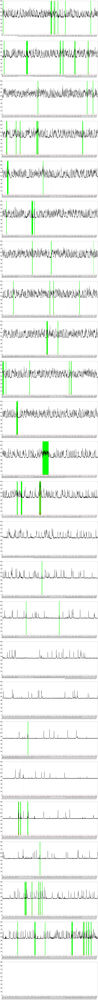

In [16]:
anorm=(d*5)**2
validate.figure(test_v, anorm, d, thr)

In [19]:
test_v['lab_z']=0
test_v.loc[(test_v['label']==1)&(test_v['z']==1), 'lab_z']=1

In [20]:
test_v

,original,label,d,z,lab_z
0,46.9,0,0.008577,0,0
1,47.2,0,0.008577,0,0
2,47.4,0,0.008577,0,0
3,47.8,0,0.008577,0,0
4,47.9,0,0.008577,0,0
...,...,...,...,...,...
431980,45.0,0,0.007723,0,0
431981,45.2,0,0.006869,0,0
431982,45.1,0,0.002748,0,0
431983,45.1,0,0.000000,0,0


In [21]:
test

,original,original_lag1,original_lag2,original_lag3,original_lag4
0,47.9,47.8,47.4,47.2,46.9
1,47.8,47.9,47.8,47.4,47.2
2,48.4,47.8,47.9,47.8,47.4
3,49.0,48.4,47.8,47.9,47.8
4,49.7,49.0,48.4,47.8,47.9
...,...,...,...,...,...
431976,45.0,45.4,45.1,44.8,45.4
431977,45.2,45.0,45.4,45.1,44.8
431978,45.1,45.2,45.0,45.4,45.1
431979,45.1,45.1,45.2,45.0,45.4


In [25]:
test['z']=test_v[4: ]['lab_z'].values

In [26]:
test

,original,original_lag1,original_lag2,original_lag3,original_lag4,z
0,47.9,47.8,47.4,47.2,46.9,0
1,47.8,47.9,47.8,47.4,47.2,0
2,48.4,47.8,47.9,47.8,47.4,0
3,49.0,48.4,47.8,47.9,47.8,0
4,49.7,49.0,48.4,47.8,47.9,0
...,...,...,...,...,...,...
431976,45.0,45.4,45.1,44.8,45.4,0
431977,45.2,45.0,45.4,45.1,44.8,0
431978,45.1,45.2,45.0,45.4,45.1,0
431979,45.1,45.1,45.2,45.0,45.4,0


In [29]:
#TSNE
reduced = TSNE(n_components=2, random_state=0).fit_transform(test[test.columns[:-1]])
reduced

array([[-20.115585, -20.201487],
       [-19.451088, -17.817682],
       [-21.545567, -15.867146],
       ...,
       [ -9.60638 ,  12.72652 ],
       [ -4.089672,  16.472193],
       [-18.3263  ,  13.297691]], dtype=float32)

In [32]:
red_df=pd.DataFrame(reduced)
red_df=pd.concat([red_df, test['z']], axis=1)
red_df

,0,1,z
0,-20.115585,-20.201487,0
1,-19.451088,-17.817682,0
2,-21.545567,-15.867146,0
3,7.841099,1.109349,0
4,-13.029153,-12.014817,0
...,...,...,...
431976,-0.837988,8.559423,0
431977,-7.987852,16.395935,0
431978,-9.606380,12.726520,0
431979,-4.089672,16.472193,0


C:\Users\Arakawa\anaconda3\lib\site-packages\IPython\core\pylabtools.py:151: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


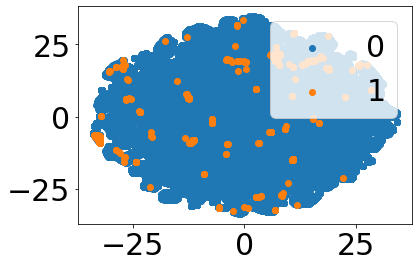

In [33]:
for label in [0, 1]:
    x=red_df[red_df['z']==label]
    plt.scatter(x[0], x[1], label=label )
plt.legend()

In [35]:
#TSNE
reduced_3d = TSNE(n_components=3, random_state=0).fit_transform(test[test.columns[:-1]])
reduced_3d

KeyboardInterrupt: 

In [ ]:
red_3df=pd.DataFrame(reduced_3d)
red_3df=pd.concat([red_3df, test['z']], axis=1)
red_3df

In [ ]:
for label in [0, 1]:
    fig=plt.figure()
    ax=fig.add_subplot(projection='3d')
    x=red_3df[red_df['z']==label]
    ax.scatter(x[0], x[1], x[2], label=label)
plt.legend()

In [37]:
test

,original,original_lag1,original_lag2,original_lag3,original_lag4,z
0,47.9,47.8,47.4,47.2,46.9,0
1,47.8,47.9,47.8,47.4,47.2,0
2,48.4,47.8,47.9,47.8,47.4,0
3,49.0,48.4,47.8,47.9,47.8,0
4,49.7,49.0,48.4,47.8,47.9,0
...,...,...,...,...,...,...
431976,45.0,45.4,45.1,44.8,45.4,0
431977,45.2,45.0,45.4,45.1,44.8,0
431978,45.1,45.2,45.0,45.4,45.1,0
431979,45.1,45.1,45.2,45.0,45.4,0


In [42]:
from sklearn.decomposition import PCA
##主成分分析（次元削減）
pca_step_minute=30
pca_step_data_num=int((pca_step_minute*60)/0.2)
train_df_list=[]
for i in range(int(len(test)/pca_step_data_num)+1):
    train_pca=PCA(n_components=3)
    train_pca.fit(test.iloc[i*pca_step_data_num:(i+1)*pca_step_data_num][test.columns[:-1]])
    train_data=train_pca.transform(test.iloc[i*pca_step_data_num:(i+1)*pca_step_data_num][test.columns[:-1]])
    tmp=pd.DataFrame(train_data)
    train_df_list.append(tmp)
train=pd.concat(train_df_list).reset_index(drop=True)
red_3df=pd.concat([train, test['z']], axis=1)
red_3df

,0,1,2,z
0,-13.708870,0.823026,0.074344,0
1,-13.305775,0.543674,0.291747,0
2,-12.770071,0.606503,0.007802,0
3,-12.055814,0.908796,-0.447355,0
4,-11.206073,1.526341,-0.361825,0
...,...,...,...,...
431976,-11.499525,-0.003086,-0.062197,0
431977,-11.587918,0.200612,0.331699,0
431978,-11.454240,-0.074961,0.011574,0
431979,-11.454923,-0.136868,-0.051333,0


<IPython.core.display.Javascript object>


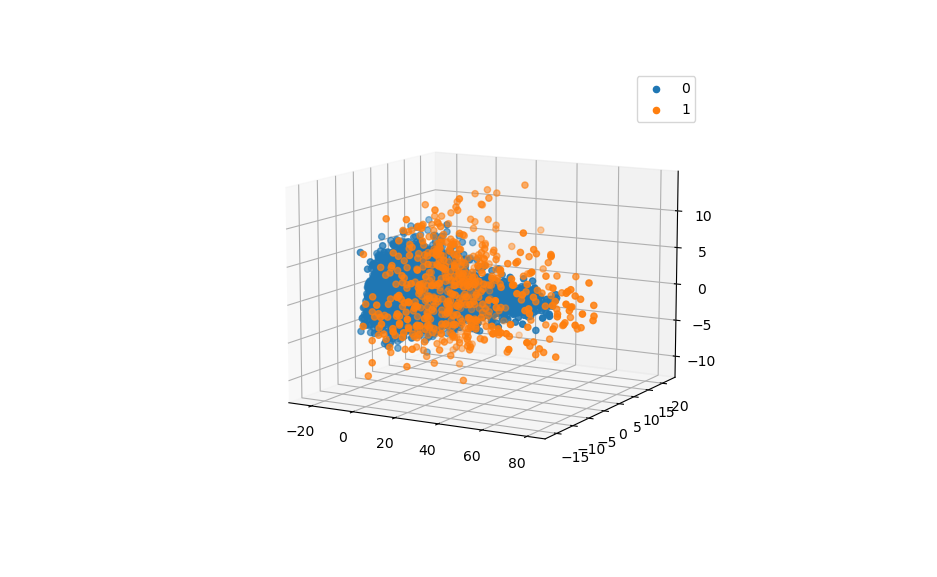

In [47]:

%matplotlib notebook
plt.rcParams["font.size"] = 10
fig=plt.figure()
ax=fig.add_subplot(projection='3d')
for label in [0, 1]:
    x=red_3df[red_df['z']==label]
    ax.scatter(x[0], x[1], x[2], label=label)
plt.legend()